In [3]:
import cv2 as cv
import numpy as np
import imutils
import matplotlib.pyplot as plt

In [4]:
def print_image(image):
    plt.figure(figsize=(50, 50))
    plt.subplot(),plt.imshow(image)
    plt.xticks([]),plt.yticks([])
    plt.show()

In [3]:
def find_circles_no_params(path):
    img_ = cv.imread(path)
    gray_ = cv.cvtColor(img_, cv.COLOR_BGR2GRAY)
    circles = cv.HoughCircles(gray_,cv.HOUGH_GRADIENT_ALT,1.5,10,
                            param1=1,param2=0.4,minRadius=0,maxRadius=20)
    circles = np.uint16(np.around(circles))
    for i in circles[0,:]:
        cv.circle(img_,(i[0],i[1]),i[2],(0,255,0),2)
    print_image(img_)
    
# (i[0],i[1]),i[2] - (x, y), r - координаты центра и радиус
# cirlesх[0,:] -массив таких троек
# функция без параметров, ищет все круги

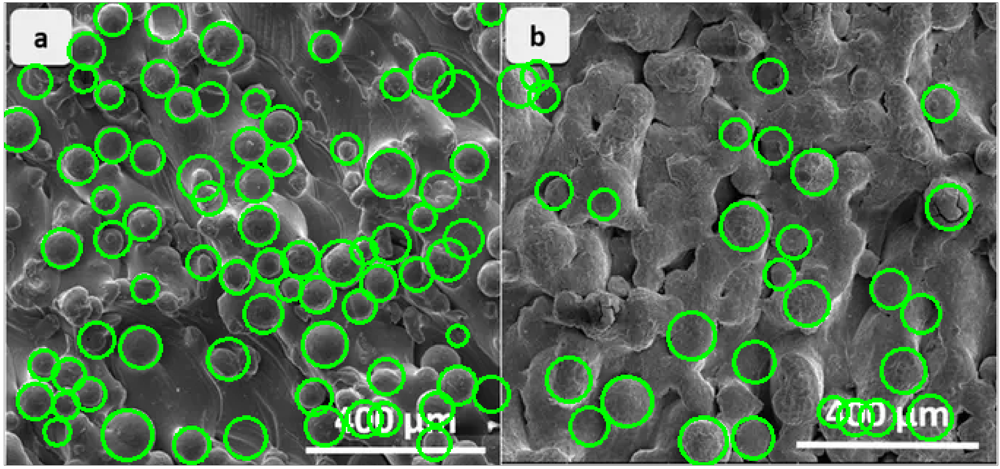

In [4]:
find_circles_no_params('/Users/liyakul/Desktop/proekt/microphoto.jpg')
# на самом деле параметры ручками подбирались под эту фотку, для других фото нужны другие

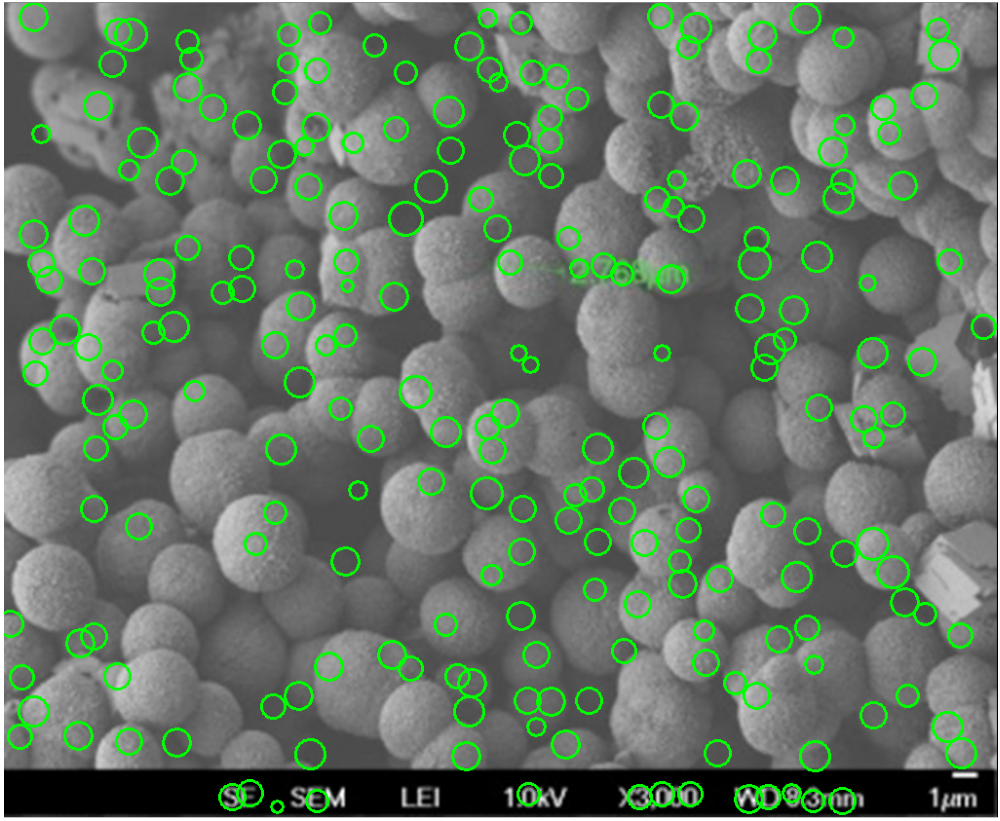

In [5]:
find_circles_no_params('/Users/liyakul/Desktop/proekt/microphoto2.png')

In [98]:
def find_circles_with_params(path, dp_=1, minDist_=10, param1_=1, param2_=0.5, minRadius_=0, maxRadius_=30):
#     minDist_ = maxRadius_ // 2
    img_ = cv.imread(path)
    gray_ = cv.cvtColor(img_, cv.COLOR_BGR2GRAY)
    circles = cv.HoughCircles(gray_,cv.HOUGH_GRADIENT_ALT, dp=dp_,minDist=minDist_,
                            param1=param1_,param2=param2_,minRadius=minRadius_,maxRadius=maxRadius_)
    circles = np.uint16(np.around(circles))
    for i in circles[0,:]:
        if 0 <= i[2] <= 20:
            cv.circle(img_,(i[0],i[1]),i[2],(0,255,0),2)
        elif 20 < i[2] <= 40:
            cv.circle(img_,(i[0],i[1]),i[2],(255,0,0),2)
        elif 40 < i[2]:
            cv.circle(img_,(i[0],i[1]),i[2],(0,0,255),2)
    print_image(img_)
    
# path - путь к фото
# dp - коэф. уменьшения изображение (рекомендуется 1,5, если не нужно находить маленькие круги)
# minDist - минимальное расстояние между радиусами
# param1 - какой-то математический параметр
# param2 - насколько хорошо ищутся окружности. Рекомендуется 0.9, но у нас маленькие круги
# minRadius, maxRadius - минимальный и максимальный радиусы искомых окружностей

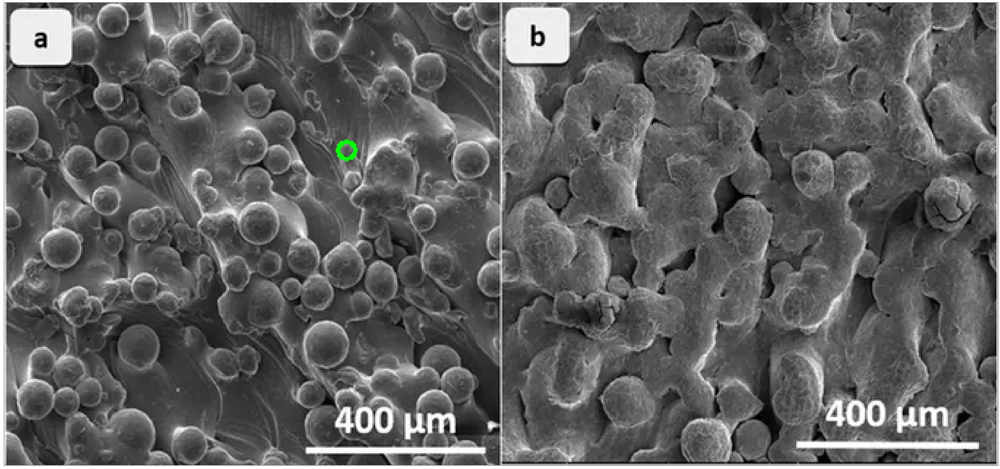

In [99]:
find_circles_with_params('/Users/liyakul/Desktop/proekt/microphoto.jpg', maxRadius_=8)
# find_circles_with_params('/Users/liyakul/Desktop/proekt/microphoto2.png', maxRadius_=8)
# здесь я долго ищу, при каких значениях сколько кругов выдает функция, чтобы в дальнейшем она могла работать
# от меньшего количества параметров (остальные будут зависеть от них)

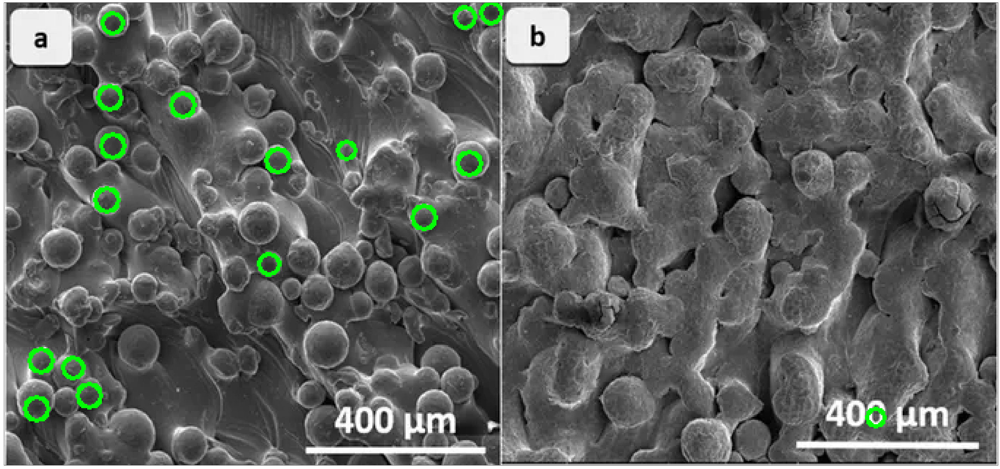

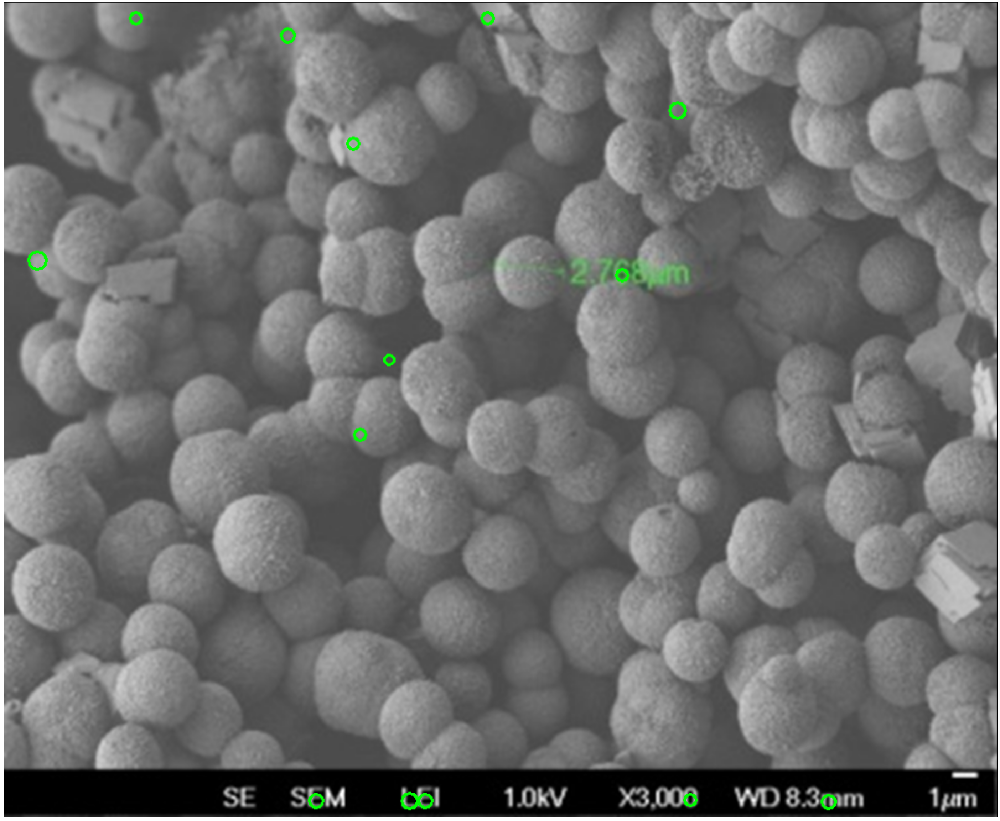

In [100]:
find_circles_with_params('/Users/liyakul/Desktop/proekt/microphoto.jpg', maxRadius_=10)
find_circles_with_params('/Users/liyakul/Desktop/proekt/microphoto2.png', maxRadius_=10)

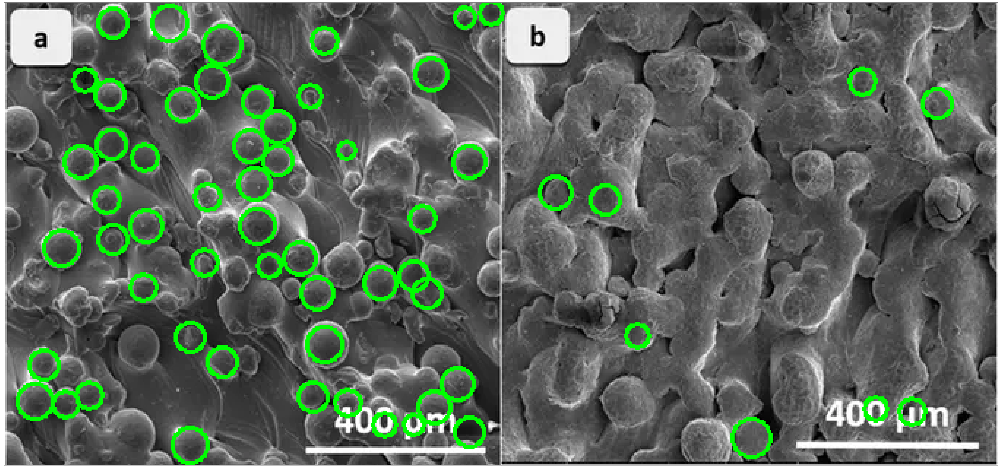

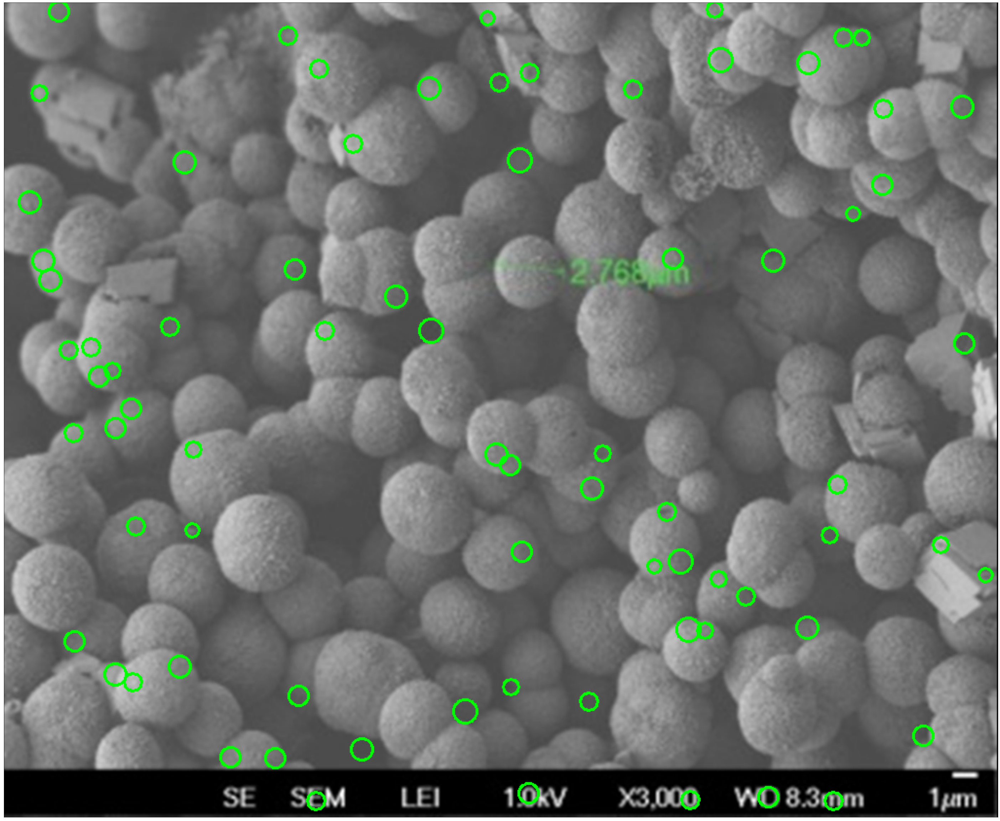

In [101]:
find_circles_with_params('/Users/liyakul/Desktop/proekt/microphoto.jpg', maxRadius_=15)
find_circles_with_params('/Users/liyakul/Desktop/proekt/microphoto2.png', maxRadius_=15)

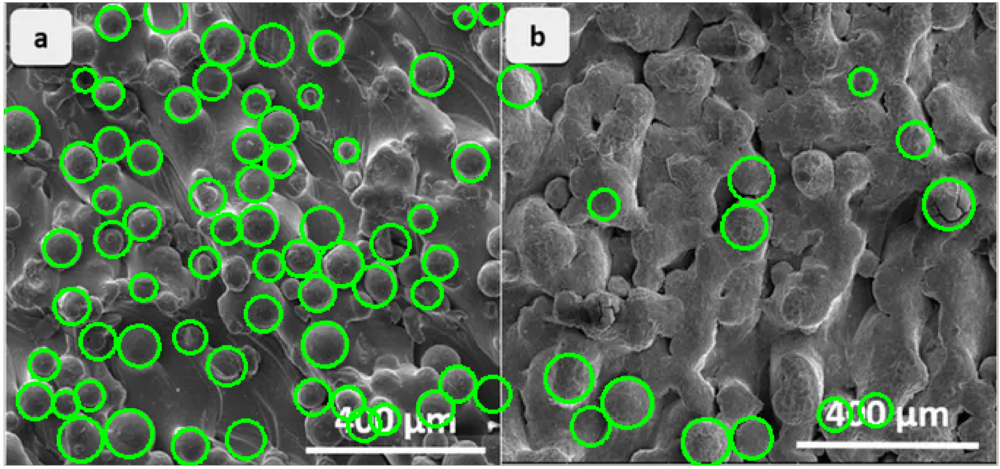

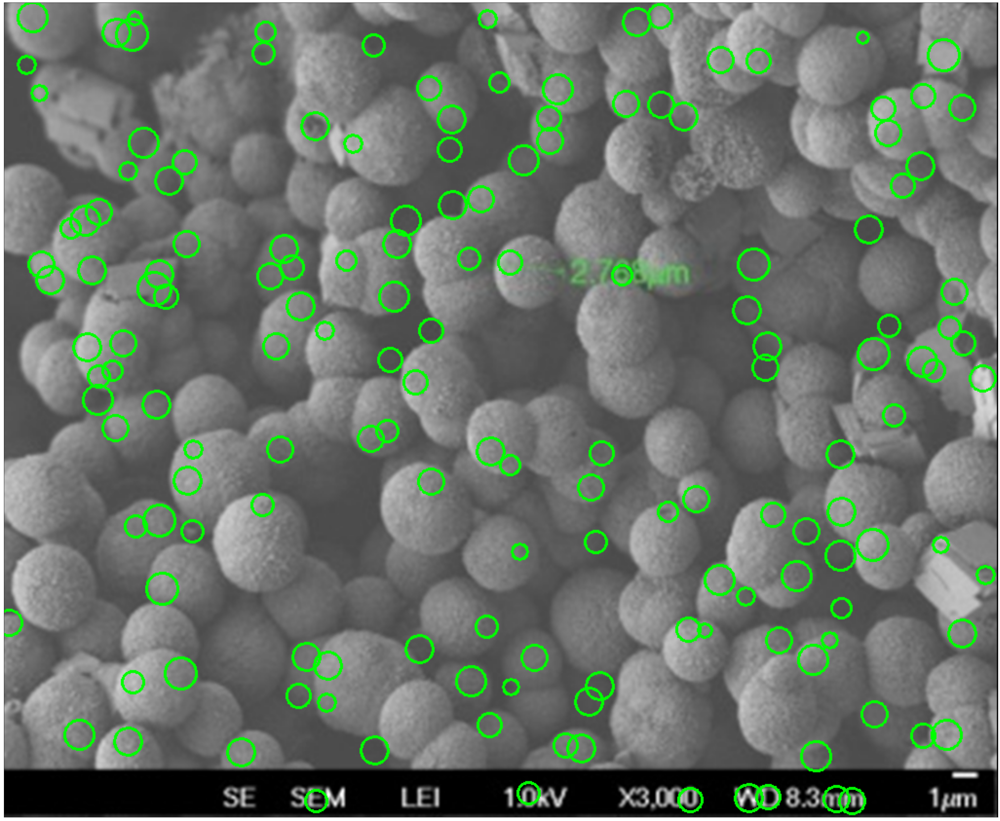

In [102]:
find_circles_with_params('/Users/liyakul/Desktop/proekt/microphoto.jpg', maxRadius_=20)
find_circles_with_params('/Users/liyakul/Desktop/proekt/microphoto2.png', maxRadius_=20)

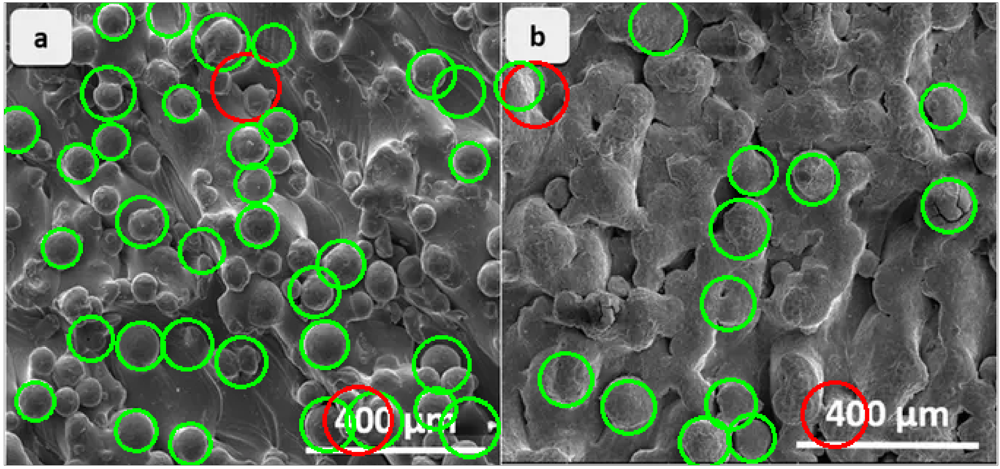

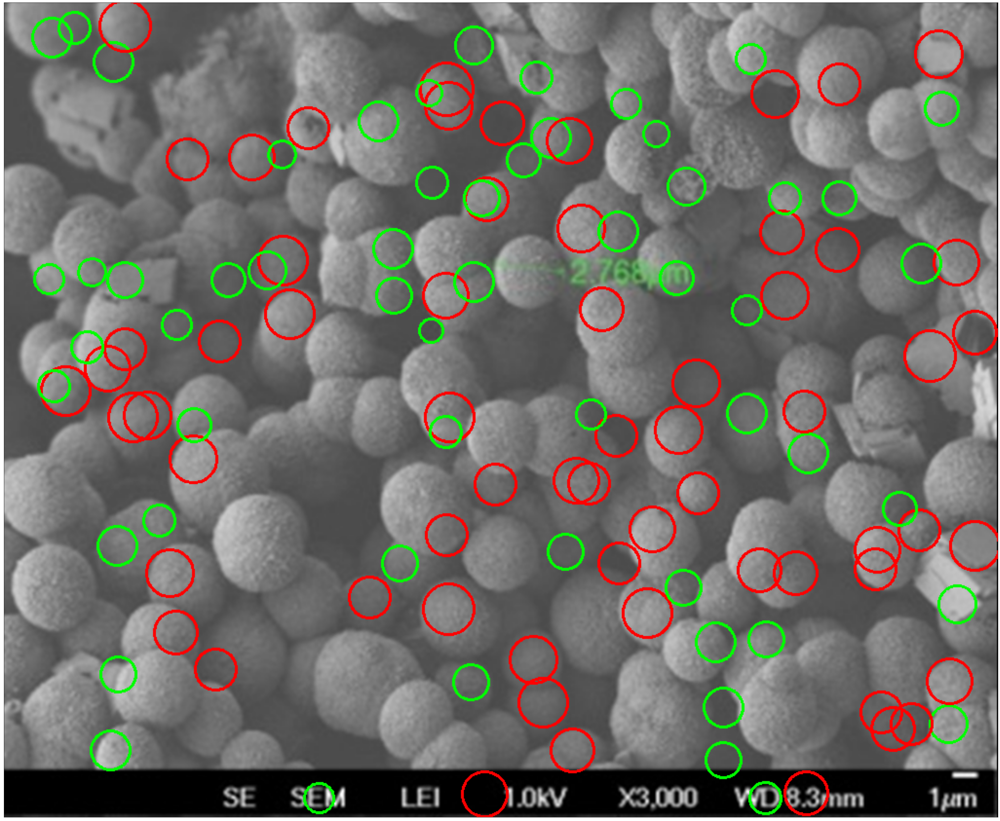

In [103]:
find_circles_with_params('/Users/liyakul/Desktop/proekt/microphoto.jpg', minRadius_=10, maxRadius_=30)
find_circles_with_params('/Users/liyakul/Desktop/proekt/microphoto2.png', minRadius_=10, maxRadius_=30)

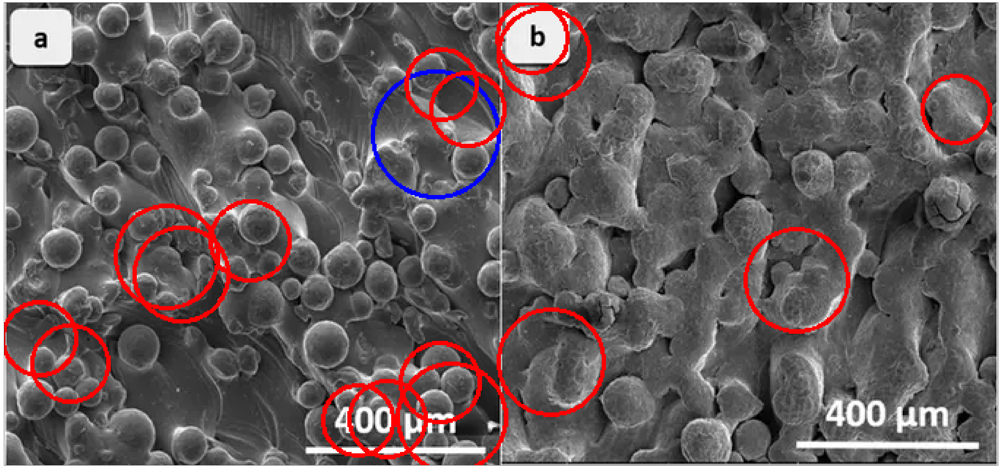

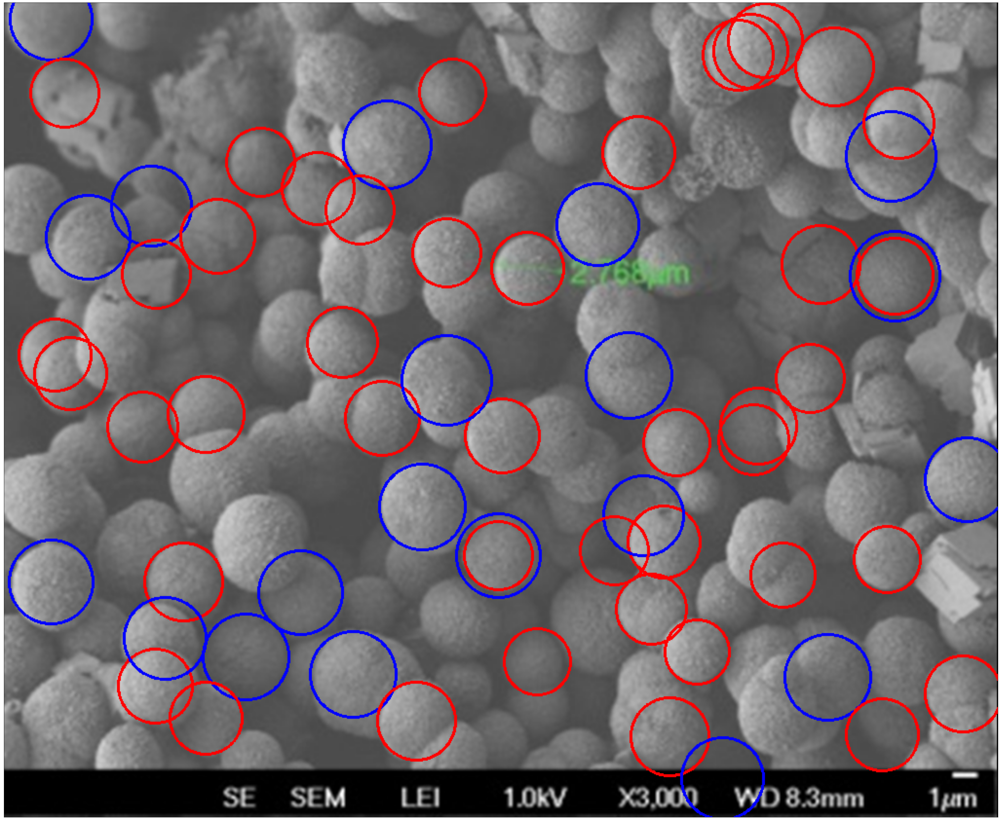

In [104]:
find_circles_with_params('/Users/liyakul/Desktop/proekt/microphoto.jpg', minRadius_=20, maxRadius_=50)
find_circles_with_params('/Users/liyakul/Desktop/proekt/microphoto2.png',minDist_=12, minRadius_=30, maxRadius_=50)

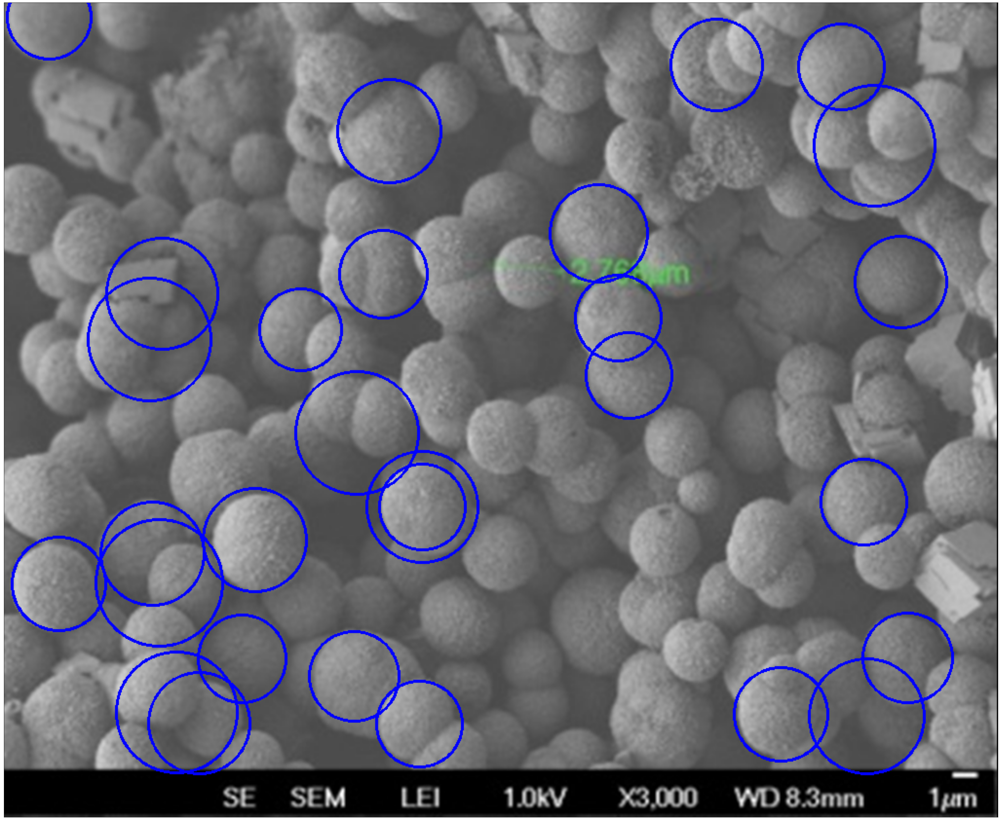

In [105]:
find_circles_with_params('/Users/liyakul/Desktop/proekt/microphoto2.png', minDist_=17, minRadius_=40, maxRadius_=70)

На этих фотках проблемы возникали с тем, что в первом случае окружности маленькие из-за маленького масштаба. Поэтому я искала пропорции относительно размера фото, чтобы не было проблем как с функцией find_circles_with_no_params( ). minDist зависит от радиусов, скорее всего линейно.

In [65]:
def find_circles(path): # def find_circles(path, radius, eps):
    # тут нужно как-то сконвертитровать единицы измерения
    
    img = cv.imread(path)
    height, width, _ = img.shape
    gray = cv.cvtColor(img, cv.COLOR_BGR2GRAY)
#     if radius > min(height, width) // 10:
#         dp = 1.5
#         param2_ = 0.9
#         param1 = 300
#         minRadius = radius - eps
#         color = 1
#     elif radius > min(height, width) // 15:
#         dp = 1.5
#         param2 = 0.8
#         param1 = 200
#         minRadius = radius - eps
#         color = 2
#     elif radius > min(height, width) // 30:
#         dp = 1
#         param2 = 0.5
#         param1 = 1
#         minRadius = max(0, radius - eps)
#         color = 3
# я пыталась найти закономерность между размером фотографии, нужным радиусом и количеством попадаемых шаров, 
# но после 15 тестов (я не стала их все здесь оставлять), что проще найти какие-то средние параметры, 
# найти все круги и выделить круги нужного размера
    
    circles = cv.HoughCircles(gray,cv.HOUGH_GRADIENT_ALT,dp=1.5,minDist=15,
                            param1=50,param2=0.5, minRadius=min(height, width)//60, maxRadius=max(height, width)//20)
    circles = np.uint16(np.around(circles))
    for i in circles[0,:]:
        if 0 <= i[2] <= 20:
            cv.circle(img,(i[0],i[1]),i[2],(0,255,0),2)
        elif 20 < i[2] <= 40:
            cv.circle(img,(i[0],i[1]),i[2],(255,0,0),2)
        elif 40 < i[2]:
            cv.circle(img,(i[0],i[1]),i[2],(0,0,255),2)
    print_image(img)

In [5]:
print((cv.imread('/Users/liyakul/Desktop/proekt/microphoto2.png')).shape)
(cv.imread('/Users/liyakul/Desktop/proekt/microphoto.jpg')).shape

(837, 1020, 3)


(317, 680, 3)

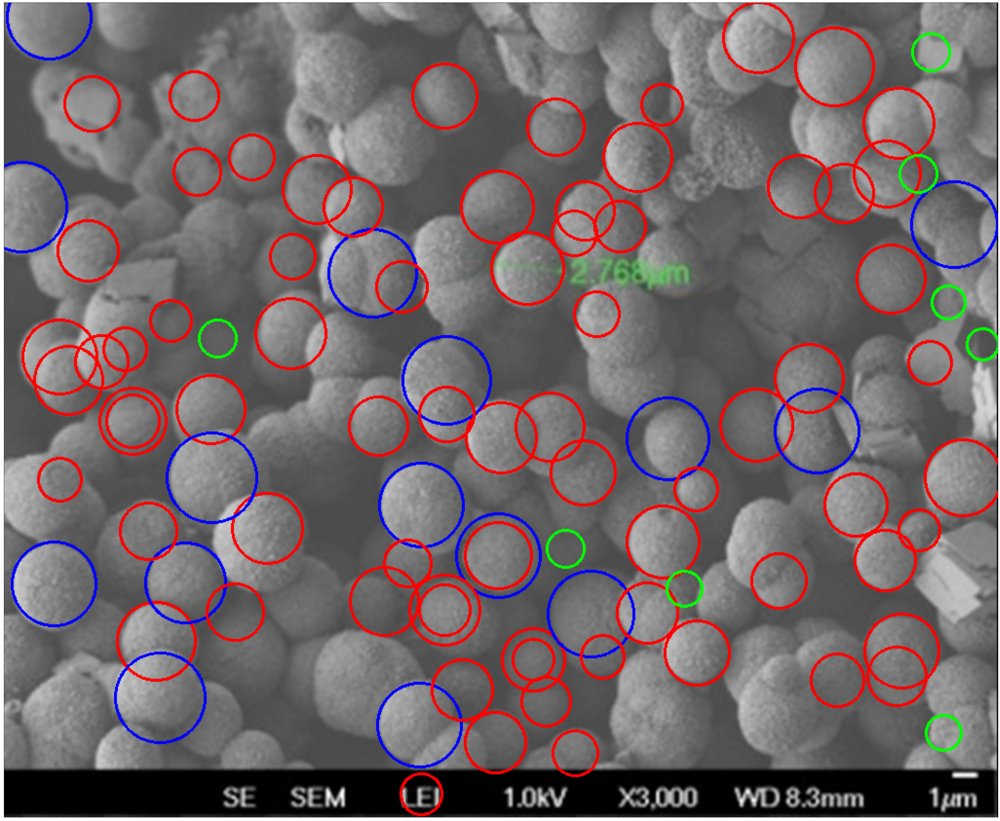

In [66]:
find_circles('/Users/liyakul/Desktop/proekt/microphoto2.png')

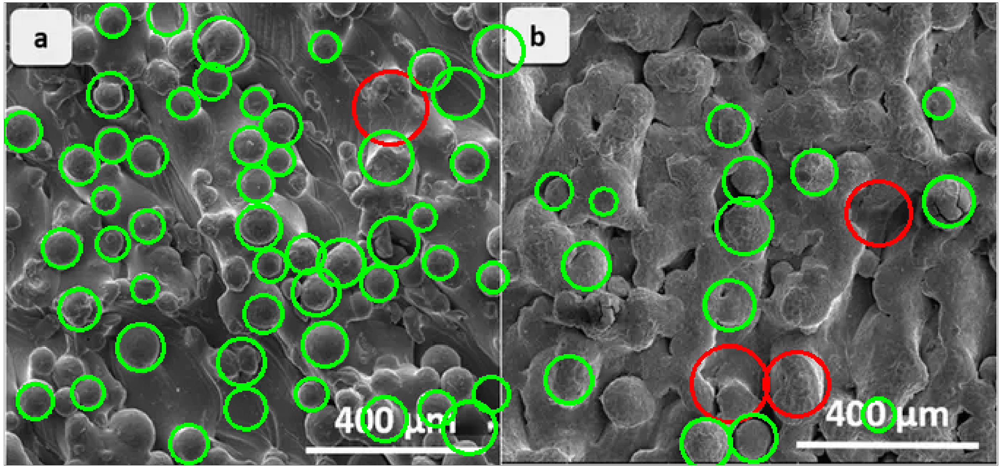

In [67]:
find_circles('/Users/liyakul/Desktop/proekt/microphoto.jpg')

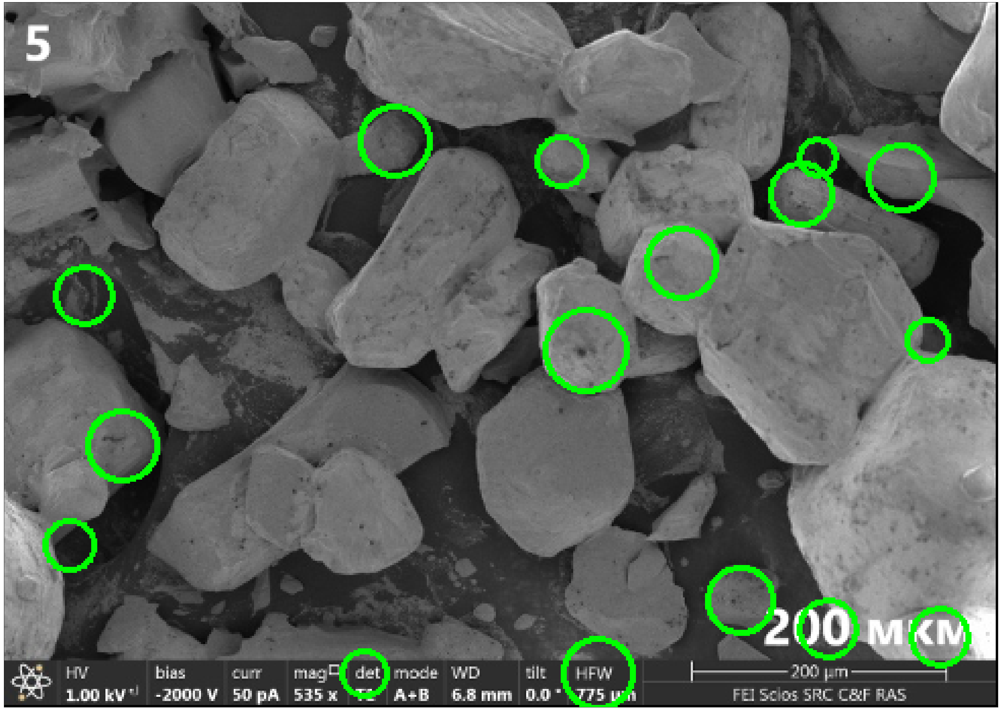

In [68]:
find_circles('/Users/liyakul/Desktop/proekt/microphoto7.png') # просто было интересно

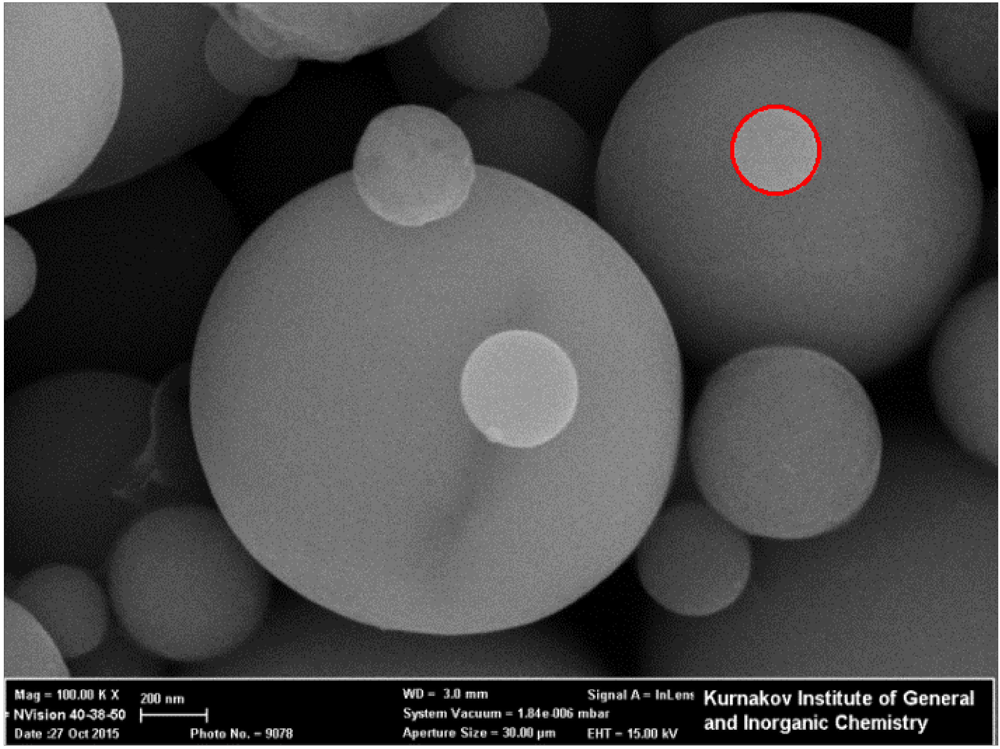

In [69]:
find_circles('/Users/liyakul/Desktop/СЭМ ШАР/3.bmp')

Этот снимок, конечно, особенный. Сложно найти какие-то универсальные константы для всех

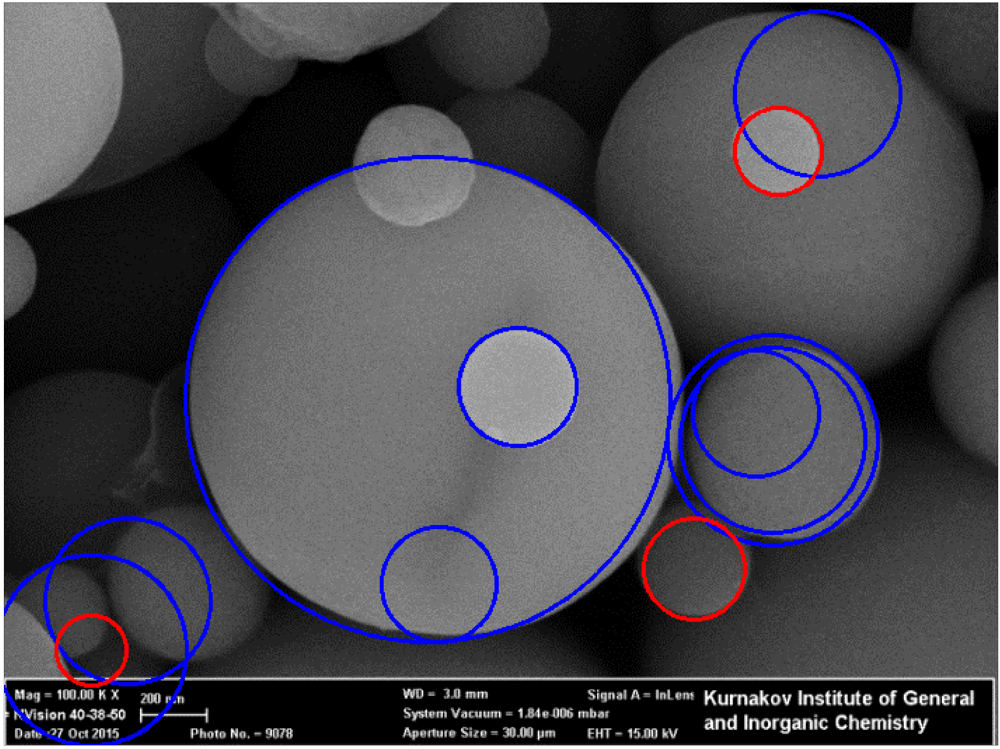

In [106]:
find_circles_with_params(path='/Users/liyakul/Desktop/СЭМ ШАР/3.bmp', minDist_=16,param1_=1, param2_=0.2,minRadius_=10,maxRadius_=0)

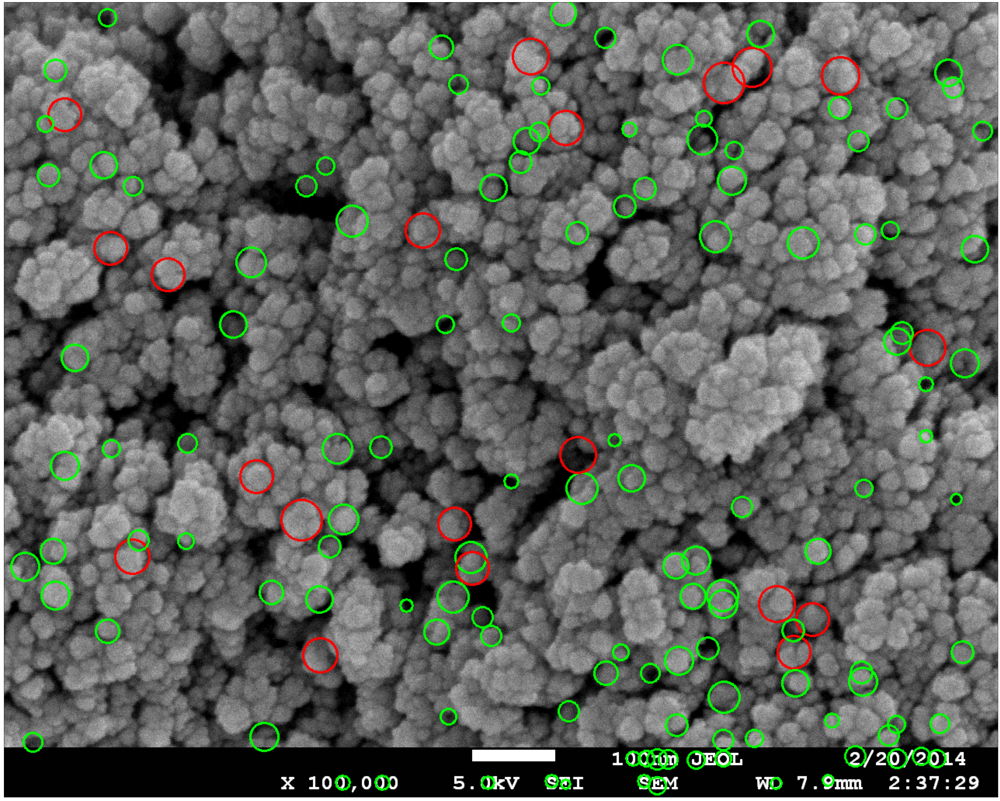

In [115]:
find_circles_with_params(path='/Users/liyakul/Desktop/СЭМ ШАР/ACYA_NA66 -13.bmp', param2_=0.3, minRadius_=0)

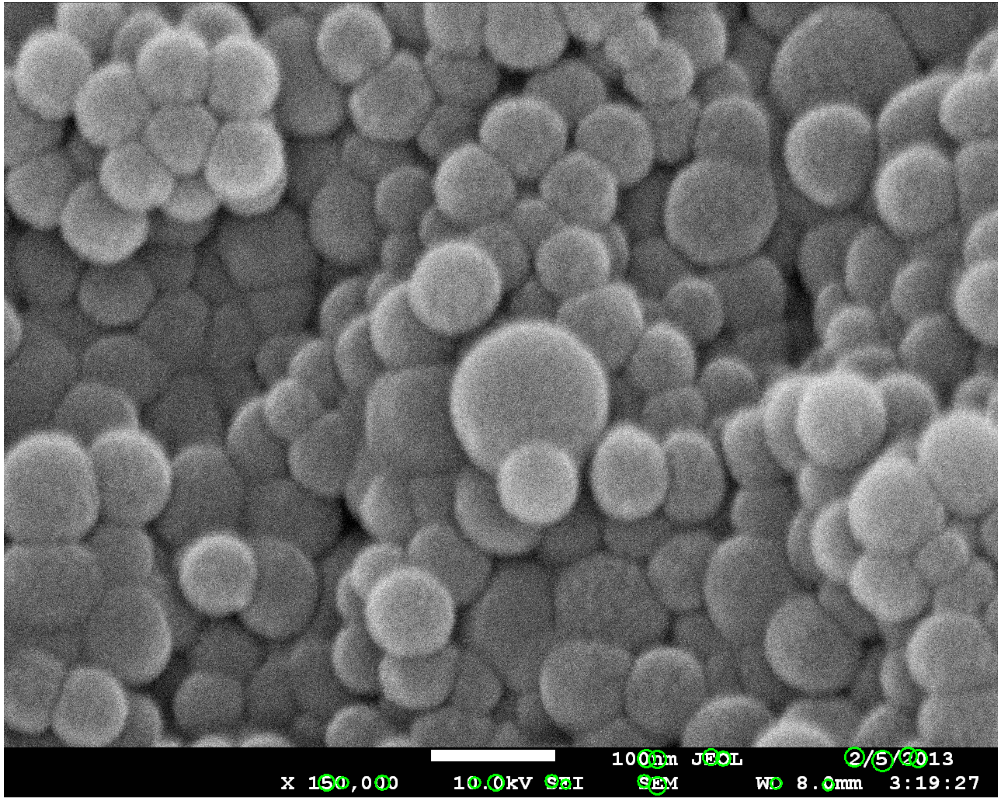

In [117]:
find_circles_with_params(path='/Users/liyakul/Desktop/СЭМ ШАР/NA64-07.bmp', param2_=0.3, minRadius_=0) # :(